# Trabalho - Grupo 3 (Catia, Eduardo, Jadhy, Laercio, Poliana)

## Top songs spotify - 2010 a 2019

### Perguntas:

#### 1- Qual o gênero e o artista mais tocado?

--> Sub análise por ano

#### 2- Qual a preferência das pessoas: música cantada ou instrumental? música acustica ou eletrônica?

#### 3- Qual a faixa de bpm mais escutada? 

--> Por faixa

--> Média e desvio padrão (quanto varia essa preferência)

#### 4- Quantas músicas são de sofrência e quantas são mais felizes?

#### 5- Qual a relação entre a energia da música, os dB e o bpm?

#### 6- Qual a relação entre a dançabilidade da música e a popularidade? 

#### 7- Qual a relação entre o ano que esteve no top e o lançamento

#### 8- Qual o máximo de anos que uma música permaneceu no top?

#### 9- Qual o tipo de artista mais tocado?

Link: https://www.kaggle.com/datasets/muhmores/spotify-top-100-songs-of-20152019

Dic de dados: http://organizeyourmusic.playlistmachinery.com/

In [1]:
import pandas as pd
import numpy as np
import os

%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

from collections import Counter, OrderedDict
import warnings
warnings.filterwarnings('ignore')

In [2]:
#Ler documentos na pasta para verificar o nome do arquivo
os.listdir()

['Grupo 3 - Trabalho.ipynb',
 'Spotify 2010 - 2019 Top 100.csv',
 'Extras',
 '.git',
 'README.md',
 '.ipynb_checkpoints']

In [3]:
#Abrindo o arquivo e verificando a cabeça
arquivo = 'Spotify 2010 - 2019 Top 100.csv'
df = pd.read_csv(arquivo)
df.head()

,title,artist,top genre,year released,added,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop,top year,artist type
0,STARSTRUKK (feat. Katy Perry),3OH!3,dance pop,2009.0,2022‑02‑17,140.0,81.0,61.0,-6.0,23.0,23.0,203.0,0.0,6.0,70.0,2010.0,Duo
1,My First Kiss (feat. Ke$ha),3OH!3,dance pop,2010.0,2022‑02‑17,138.0,89.0,68.0,-4.0,36.0,83.0,192.0,1.0,8.0,68.0,2010.0,Duo
2,I Need A Dollar,Aloe Blacc,pop soul,2010.0,2022‑02‑17,95.0,48.0,84.0,-7.0,9.0,96.0,243.0,20.0,3.0,72.0,2010.0,Solo
3,Airplanes (feat. Hayley Williams of Paramore),B.o.B,atl hip hop,2010.0,2022‑02‑17,93.0,87.0,66.0,-4.0,4.0,38.0,180.0,11.0,12.0,80.0,2010.0,Solo
4,Nothin' on You (feat. Bruno Mars),B.o.B,atl hip hop,2010.0,2022‑02‑17,104.0,85.0,69.0,-6.0,9.0,74.0,268.0,39.0,5.0,79.0,2010.0,Solo


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1003 entries, 0 to 1002
Data columns (total 17 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   title          1000 non-null   object 
 1   artist         1000 non-null   object 
 2   top genre      1000 non-null   object 
 3   year released  1000 non-null   float64
 4   added          1000 non-null   object 
 5   bpm            1000 non-null   float64
 6   nrgy           1000 non-null   float64
 7   dnce           1000 non-null   float64
 8   dB             1000 non-null   float64
 9   live           1000 non-null   float64
 10  val            1000 non-null   float64
 11  dur            1000 non-null   float64
 12  acous          1000 non-null   float64
 13  spch           1000 non-null   float64
 14  pop            1000 non-null   float64
 15  top year       1000 non-null   float64
 16  artist type    1000 non-null   object 
dtypes: float64(12), object(5)
memory usage: 133.3+ KB


5 variáveis categóricas: Título, artista, gênero, added (dia que a música foi pro top), tipo de artista

O resto das variáveis são numéricas

In [5]:
display(df[df.isna().any(axis=1)])
df.dropna(inplace=True)
df.info()

,title,artist,top genre,year released,added,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop,top year,artist type
1000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<class 'pandas.core.frame.DataFrame'>
Int64Index: 1000 entries, 0 to 999
Data columns (total 17 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   title          1000 non-null   object 
 1   artist         1000 non-null   object 
 2   top genre      1000 non-null   object 
 3   year released  1000 non-null   float64
 4   added          1000 non-null   object 
 5   bpm            1000 non-null   float64
 6   nrgy           1000 non-null   float64
 7   dnce           1000 non-null   float64
 8   dB             1000 non-null   float64
 9   live           1000 non-null   float64
 10  val            1000 non-null   float64
 11  dur            1000 non-null   float64
 12  acous          1000 non-null   float64
 13  spch           1000 non-null   float64
 14  pop            1000 non-null   float64
 15  top year       1000 non-null   float64
 16  artist type    1000 non-null   object 
dtypes: float64(12), object(5)
memory usage: 140.6+ KB


Nota-se que possuia 3 linhas de cada coluna que apresentam valores nulos, como mostrado anteriormente, e foram removidas.

Nota-se também que Top Year, Year Released e BPM, então sendo tratados como Float, porém essas variáveis no mundo real se enquadram como inteiros. Portanto, sua conversão é feita a seguir:

In [6]:
df = df.astype({"top year":int, "year released" : int, "bpm": int})
display(df.head())
df.info()

,title,artist,top genre,year released,added,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop,top year,artist type
0,STARSTRUKK (feat. Katy Perry),3OH!3,dance pop,2009,2022‑02‑17,140,81.0,61.0,-6.0,23.0,23.0,203.0,0.0,6.0,70.0,2010,Duo
1,My First Kiss (feat. Ke$ha),3OH!3,dance pop,2010,2022‑02‑17,138,89.0,68.0,-4.0,36.0,83.0,192.0,1.0,8.0,68.0,2010,Duo
2,I Need A Dollar,Aloe Blacc,pop soul,2010,2022‑02‑17,95,48.0,84.0,-7.0,9.0,96.0,243.0,20.0,3.0,72.0,2010,Solo
3,Airplanes (feat. Hayley Williams of Paramore),B.o.B,atl hip hop,2010,2022‑02‑17,93,87.0,66.0,-4.0,4.0,38.0,180.0,11.0,12.0,80.0,2010,Solo
4,Nothin' on You (feat. Bruno Mars),B.o.B,atl hip hop,2010,2022‑02‑17,104,85.0,69.0,-6.0,9.0,74.0,268.0,39.0,5.0,79.0,2010,Solo


<class 'pandas.core.frame.DataFrame'>
Int64Index: 1000 entries, 0 to 999
Data columns (total 17 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   title          1000 non-null   object 
 1   artist         1000 non-null   object 
 2   top genre      1000 non-null   object 
 3   year released  1000 non-null   int64  
 4   added          1000 non-null   object 
 5   bpm            1000 non-null   int64  
 6   nrgy           1000 non-null   float64
 7   dnce           1000 non-null   float64
 8   dB             1000 non-null   float64
 9   live           1000 non-null   float64
 10  val            1000 non-null   float64
 11  dur            1000 non-null   float64
 12  acous          1000 non-null   float64
 13  spch           1000 non-null   float64
 14  pop            1000 non-null   float64
 15  top year       1000 non-null   int64  
 16  artist type    1000 non-null   object 
dtypes: float64(9), int64(3), object(5)
memory usage: 140.

In [7]:
#Não possui linhas duplicadas

df[df.duplicated()]

,title,artist,top genre,year released,added,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop,top year,artist type


In [8]:
# Número de valores únicos para cada atributo
df.nunique()

title            945
artist           444
top genre        132
year released     14
added             26
bpm              122
nrgy              80
dnce              68
dB                16
live              67
val               93
dur              176
acous             89
spch              50
pop               55
top year          10
artist type        4
dtype: int64

In [9]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
year released,1000.0,2014.390,3.241359,1975.0,2012.0,2014.0,2017.00,2021.0
bpm,1000.0,121.262,26.238022,65.0,100.0,122.0,134.00,206.0
nrgy,1000.0,69.502,15.961415,6.0,59.0,71.0,81.25,98.0
dnce,1000.0,66.876,13.121921,19.0,59.0,68.0,75.00,96.0
dB,1000.0,-5.663,2.025224,-18.0,-7.0,-5.0,-4.00,-1.0
live,1000.0,17.911,13.431511,2.0,9.0,12.0,23.00,83.0
val,1000.0,50.901,21.563399,4.0,35.0,50.5,68.00,97.0
dur,1000.0,220.406,39.927677,113.0,197.0,216.0,237.00,688.0
acous,1000.0,14.369,19.454030,0.0,2.0,6.0,19.00,98.0
spch,1000.0,10.064,9.276743,2.0,4.0,6.0,12.00,53.0


Como nenhuma das colunas pessui desvio padrão 0, então não existe coluna com valores constantes que devem ser descartadas.

#### 1- Qual o gênero e o artista mais tocado?

In [10]:
#Contando a quantidade de vezes cada um dos gêneros aparecem
tudo_generos = df['top genre'].value_counts()
tudo_generos

dance pop           361
pop                  57
atl hip hop          39
art pop              37
hip hop              21
                   ... 
french shoegaze       1
new french touch      1
hip pop               1
australian psych      1
uk drill              1
Name: top genre, Length: 132, dtype: int64

### curiosidade:

Após ver a lista de gêneros, percebemos que existia mais de um POP e ficamos curioso para saber quantos diferentes tinham e quanto eles representavam da totalidade de Gêneros Musicais da Lista completa

In [11]:
print(df[df['top genre'].str.contains('pop')]['top genre'].unique())
print(f"{(len(df[df['top genre'].str.contains('pop')]['top genre'])/len(df))*100:.2f}%")

print(df[df['top genre'] == 'dance pop']['top genre'].unique())
print(f"{(len(df[df['top genre'] == 'dance pop']['top genre'])/len(df))*100:.2f}%")


['dance pop' 'pop soul' 'pop rap' 'canadian pop' 'art pop' 'pop'
 'barbadian pop' 'acoustic pop' 'belgian pop' 'hip pop' 'baroque pop'
 'indie pop' 'indie poptimism' 'israeli pop' 'australian pop' 'candy pop'
 'folk-pop' 'k-pop' 'metropopolis' 'electropop' 'austrian pop' 'irish pop'
 'chill pop' 'french indie pop' 'german pop' 'indie pop rap' 'danish pop'
 'social media pop' 'bedroom pop' 'colombian pop' 'alternative pop rock']
56.00%
['dance pop']
36.10%


### Continuando

In [12]:
#Filtrando os Top 5 dos gêneros musicais e percebendo que existe um empate
top_generos = df['top genre'].value_counts().loc[lambda x : (x>= tudo_generos.values[4])]
top_generos

dance pop      361
pop             57
atl hip hop     39
art pop         37
hip hop         21
boy band        21
Name: top genre, dtype: int64

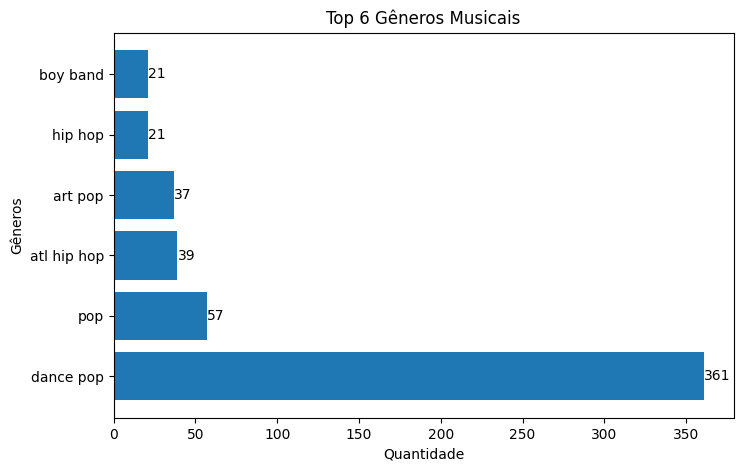

In [13]:
#Plot do gráfico dos Top 6 gêneros musicais usando o matplotlib
fig, ax = plt.subplots(figsize = (8,5))
bars = ax.barh(top_generos.index, top_generos.values)

ax.bar_label(bars)
plt.title(f'Top 6 Gêneros Musicais')
plt.xlabel(f'Quantidade')
plt.ylabel(f'Gêneros')
plt.show()

In [14]:
#Contando a quantidade de vezes cada um dos artistas aparecem
tudo_artistas = df['artist'].value_counts()
tudo_artistas

Taylor Swift     21
Drake            18
Calvin Harris    18
Rihanna          14
Ariana Grande    14
                 ..
Cold War Kids     1
Charli XCX        1
Bobby Shmurda     1
Becky G           1
Young Thug        1
Name: artist, Length: 444, dtype: int64

In [15]:
#Filtrando os Top 5 dos artistas
top_artistas = df['artist'].value_counts().loc[lambda x : (x>= tudo_artistas.values[4])]
top_artistas

Taylor Swift     21
Drake            18
Calvin Harris    18
Rihanna          14
Ariana Grande    14
Name: artist, dtype: int64

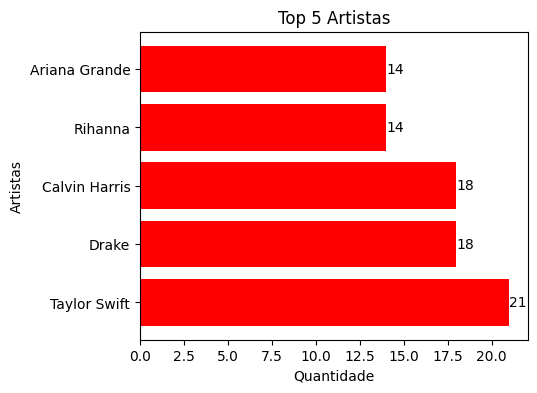

In [16]:
#Plot do gráfico dos Top 5 artistas usando o matplotlib
fig, ax = plt.subplots(figsize = (5,4))
bars = ax.barh(top_artistas.index, top_artistas.values, color = 'r')

ax.bar_label(bars)
plt.title(f'Top 5 Artistas')
plt.xlabel(f'Quantidade')
plt.ylabel(f'Artistas')
plt.show()

#### 1.1 - Qual o gênero e o artista mais tocado por ano?

In [17]:
#Separando os anos diferentes em um Array
years = df['top year'].unique()

for i in years:
    display(df[df['top year'] == i].describe())

,year released,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop,top year
count,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.0
mean,2010.120000,119.560000,76.650000,65.290000,-4.950000,20.660000,56.740000,226.450000,9.620000,9.950000,70.180000,2010.0
std,1.683431,24.625404,12.559656,12.638162,1.565893,15.690324,20.867848,33.195282,12.821841,9.305559,10.614817,0.0
min,2009.000000,65.000000,44.000000,31.000000,-9.000000,3.000000,8.000000,157.000000,0.000000,2.000000,39.000000,2010.0
25%,2010.000000,99.750000,68.000000,58.500000,-6.000000,9.000000,41.750000,205.750000,1.000000,4.000000,65.000000,2010.0
50%,2010.000000,122.500000,78.500000,66.500000,-5.000000,16.000000,58.500000,221.000000,3.000000,6.000000,71.000000,2010.0
75%,2010.000000,130.250000,86.250000,75.000000,-4.000000,29.250000,74.000000,248.000000,13.250000,13.000000,76.250000,2010.0
max,2020.000000,182.000000,98.000000,90.000000,-1.000000,83.000000,96.000000,321.000000,53.000000,45.000000,87.000000,2010.0


,year released,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop,top year
count,100.000000,100.000000,100.00000,100.000000,100.000000,100.000000,100.000000,100.000000,100.00000,100.000000,100.000000,100.0
mean,2011.060000,127.290000,76.10000,63.560000,-5.160000,18.760000,54.850000,230.190000,11.74000,8.520000,73.050000,2011.0
std,1.733916,24.596253,14.04646,11.852903,1.910735,13.676729,22.116485,32.155775,18.44381,7.661368,9.428492,0.0
min,2009.000000,75.000000,29.00000,35.000000,-15.000000,3.000000,9.000000,166.000000,0.00000,2.000000,35.000000,2011.0
25%,2010.000000,110.750000,69.75000,58.000000,-6.000000,10.000000,36.000000,205.750000,1.00000,4.000000,69.000000,2011.0
50%,2011.000000,128.000000,78.00000,66.000000,-5.000000,13.000000,56.000000,228.000000,4.50000,5.000000,74.500000,2011.0
75%,2011.000000,140.250000,86.00000,71.000000,-4.000000,26.250000,73.250000,244.000000,14.00000,10.000000,79.250000,2011.0
max,2021.000000,206.000000,96.00000,93.000000,-1.000000,67.000000,97.000000,337.000000,95.00000,45.000000,88.000000,2011.0


,year released,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop,top year
count,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.0
mean,2011.850000,123.100000,74.070000,64.010000,-5.530000,19.710000,53.290000,226.380000,9.700000,9.270000,72.850000,2012.0
std,0.592461,24.677107,16.800827,12.575023,2.418176,15.382198,22.617279,35.354705,17.995791,9.196898,9.130231,0.0
min,2010.000000,72.000000,16.000000,35.000000,-18.000000,2.000000,7.000000,157.000000,0.000000,3.000000,39.000000,2012.0
25%,2012.000000,109.500000,66.000000,58.000000,-7.000000,9.000000,34.000000,202.500000,1.000000,4.000000,68.000000,2012.0
50%,2012.000000,126.000000,78.500000,66.000000,-5.500000,13.500000,53.000000,219.000000,3.000000,5.000000,73.500000,2012.0
75%,2012.000000,130.000000,86.000000,72.000000,-4.000000,25.750000,73.000000,243.500000,10.000000,9.250000,79.000000,2012.0
max,2014.000000,202.000000,97.000000,93.000000,-2.000000,70.000000,97.000000,350.000000,95.000000,41.000000,91.000000,2012.0


,year released,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop,top year
count,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.0
mean,2012.730000,119.910000,72.440000,63.550000,-5.630000,19.130000,53.050000,229.490000,11.520000,8.160000,73.810000,2013.0
std,0.633333,25.702688,16.260704,12.378194,1.905097,14.677444,22.468553,46.551263,19.593588,7.746906,9.900204,0.0
min,2011.000000,73.000000,28.000000,19.000000,-11.000000,2.000000,4.000000,148.000000,0.000000,3.000000,44.000000,2013.0
25%,2012.000000,100.000000,61.750000,55.750000,-7.000000,9.000000,35.000000,205.500000,1.000000,4.000000,67.000000,2013.0
50%,2013.000000,124.000000,77.000000,65.500000,-5.000000,12.000000,53.000000,227.000000,3.500000,5.000000,74.000000,2013.0
75%,2013.000000,128.500000,85.000000,72.000000,-4.000000,30.250000,68.250000,244.250000,11.250000,8.250000,81.000000,2013.0
max,2016.000000,192.000000,98.000000,87.000000,-2.000000,67.000000,95.000000,484.000000,93.000000,40.000000,95.000000,2013.0


,year released,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop,top year
count,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.0
mean,2013.880000,119.730000,71.030000,65.880000,-5.460000,18.660000,50.950000,227.900000,12.290000,7.650000,74.320000,2014.0
std,0.555596,23.992783,15.296699,14.085798,1.678263,12.944497,22.877087,56.735164,19.825142,6.498446,9.022844,0.0
min,2012.000000,77.000000,15.000000,28.000000,-9.000000,2.000000,8.000000,165.000000,0.000000,3.000000,51.000000,2014.0
25%,2014.000000,100.000000,61.000000,57.000000,-7.000000,10.000000,35.000000,199.000000,1.000000,4.000000,69.000000,2014.0
50%,2014.000000,120.000000,73.500000,67.500000,-5.000000,14.000000,49.000000,218.500000,4.000000,5.000000,76.000000,2014.0
75%,2014.000000,128.000000,80.250000,74.250000,-4.000000,21.500000,67.750000,241.000000,13.500000,9.000000,82.000000,2014.0
max,2015.000000,196.000000,97.000000,96.000000,-2.000000,64.000000,96.000000,688.000000,92.000000,42.000000,90.000000,2014.0


,year released,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop,top year
count,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.00000,100.000000,100.0
mean,2014.930000,120.860000,67.530000,65.220000,-5.810000,17.880000,46.820000,218.460000,15.070000,7.66000,75.280000,2015.0
std,0.670519,27.906055,14.436524,13.401025,1.679917,13.840564,19.224027,25.545531,20.049562,5.47025,7.654246,0.0
min,2014.000000,78.000000,27.000000,26.000000,-11.000000,3.000000,10.000000,160.000000,0.000000,3.00000,55.000000,2015.0
25%,2015.000000,98.000000,57.750000,58.000000,-7.000000,9.750000,32.750000,199.000000,1.000000,4.00000,70.000000,2015.0
50%,2015.000000,120.000000,69.500000,66.000000,-6.000000,12.000000,46.500000,219.000000,6.000000,6.00000,76.000000,2015.0
75%,2015.000000,131.250000,79.000000,74.250000,-4.000000,22.250000,60.000000,232.750000,21.000000,10.00000,81.000000,2015.0
max,2018.000000,206.000000,94.000000,89.000000,-3.000000,82.000000,93.000000,284.000000,88.000000,32.00000,89.000000,2015.0


,year released,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop,top year
count,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.0
mean,2016.070000,115.770000,65.800000,64.530000,-5.970000,17.120000,46.920000,219.860000,18.420000,10.220000,75.090000,2016.0
std,1.037236,25.125887,17.459911,11.266698,2.066838,12.946104,19.778409,30.162864,21.649261,8.806081,7.052609,0.0
min,2015.000000,75.000000,6.000000,33.000000,-15.000000,4.000000,10.000000,160.000000,0.000000,3.000000,58.000000,2016.0
25%,2016.000000,100.000000,55.750000,59.750000,-7.000000,9.000000,32.250000,199.000000,3.000000,4.000000,70.000000,2016.0
50%,2016.000000,112.000000,68.500000,66.000000,-6.000000,12.500000,46.500000,214.500000,10.000000,6.500000,77.000000,2016.0
75%,2016.000000,125.000000,79.000000,71.000000,-4.750000,20.250000,59.500000,234.000000,26.250000,11.250000,80.250000,2016.0
max,2021.000000,192.000000,95.000000,92.000000,-3.000000,74.000000,90.000000,348.000000,97.000000,44.000000,88.000000,2016.0


,year released,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop,top year
count,100.000000,100.000000,100.000000,100.000000,100.00000,100.000000,100.000000,100.000000,100.0000,100.000000,100.000000,100.0
mean,2016.990000,122.020000,63.160000,73.580000,-6.08000,16.030000,47.720000,221.040000,16.2200,12.220000,77.810000,2017.0
std,0.594503,26.107385,15.296213,11.183664,2.15875,10.514497,20.349015,37.476166,19.1441,11.065991,7.672192,0.0
min,2016.000000,73.000000,23.000000,49.000000,-13.00000,4.000000,11.000000,119.000000,0.0000,2.000000,48.000000,2017.0
25%,2017.000000,101.750000,53.750000,65.000000,-7.00000,9.000000,33.750000,202.750000,3.0000,5.000000,74.750000,2017.0
50%,2017.000000,123.000000,65.000000,74.000000,-6.00000,12.000000,45.000000,216.000000,8.0000,8.000000,79.000000,2017.0
75%,2017.000000,140.000000,75.000000,81.000000,-5.00000,19.000000,61.250000,238.250000,22.0000,14.250000,83.000000,2017.0
max,2019.000000,190.000000,93.000000,94.000000,-3.00000,69.000000,93.000000,343.000000,92.0000,51.000000,91.000000,2017.0


,year released,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop,top year
count,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.0
mean,2017.850000,120.550000,65.450000,70.800000,-5.830000,15.770000,47.560000,208.790000,18.150000,13.150000,77.580000,2018.0
std,0.411329,28.427251,14.745912,13.287041,1.901913,11.716219,21.184767,41.107716,20.326315,11.101347,6.742268,0.0
min,2017.000000,65.000000,30.000000,35.000000,-13.000000,2.000000,5.000000,122.000000,0.000000,3.000000,58.000000,2018.0
25%,2018.000000,99.500000,57.000000,64.000000,-7.000000,9.000000,33.750000,185.000000,4.000000,5.000000,74.000000,2018.0
50%,2018.000000,120.000000,67.000000,70.500000,-5.500000,11.500000,46.000000,203.000000,11.000000,9.000000,77.000000,2018.0
75%,2018.000000,138.500000,77.000000,80.250000,-5.000000,17.250000,64.000000,222.500000,25.250000,18.000000,83.000000,2018.0
max,2019.000000,204.000000,91.000000,96.000000,-2.000000,74.000000,93.000000,418.000000,93.000000,53.000000,91.000000,2018.0


,year released,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop,top year
count,100.000000,100.00000,100.000000,100.000000,100.00000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.0
mean,2018.420000,123.83000,62.790000,72.340000,-6.21000,15.390000,51.110000,195.500000,20.960000,13.840000,78.430000,2019.0
std,4.406561,30.08139,14.906642,13.631677,2.48346,11.474957,22.115809,39.768649,20.496326,11.659062,6.748371,0.0
min,1975.000000,69.00000,11.000000,35.000000,-15.00000,5.000000,10.000000,113.000000,0.000000,3.000000,56.000000,2019.0
25%,2019.000000,98.75000,54.000000,63.000000,-7.00000,9.750000,34.750000,174.750000,5.750000,6.000000,74.000000,2019.0
50%,2019.000000,120.00000,63.000000,75.000000,-6.00000,11.000000,52.500000,191.000000,15.000000,9.000000,80.000000,2019.0
75%,2019.000000,145.00000,74.250000,83.000000,-5.00000,16.000000,65.750000,211.000000,32.000000,19.250000,83.000000,2019.0
max,2020.000000,202.00000,92.000000,95.000000,-2.00000,80.000000,95.000000,354.000000,98.000000,48.000000,91.000000,2019.0


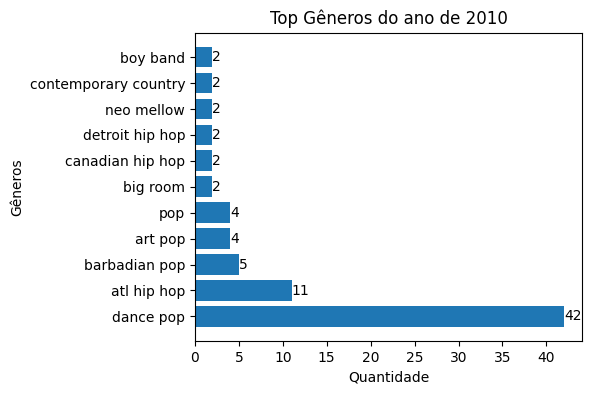

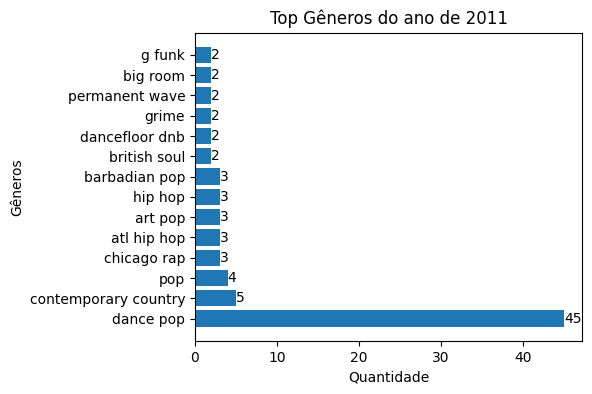

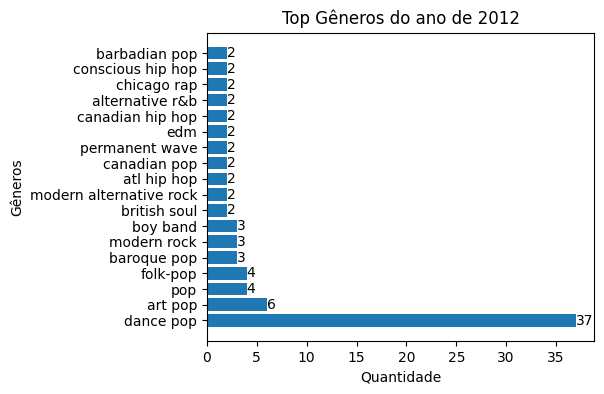

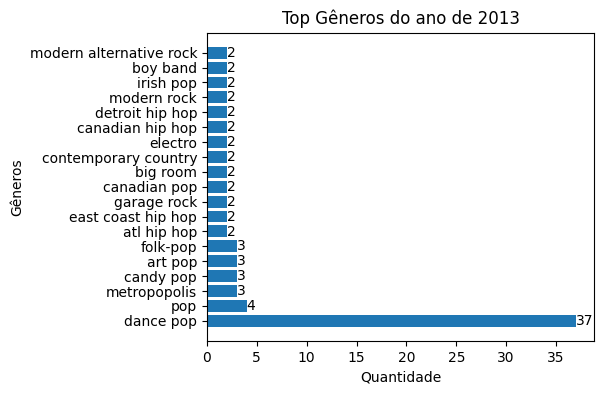

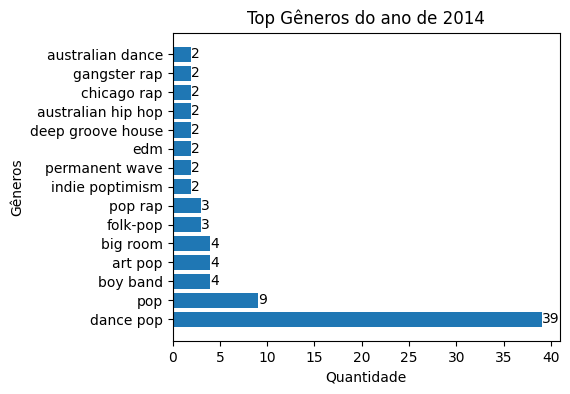

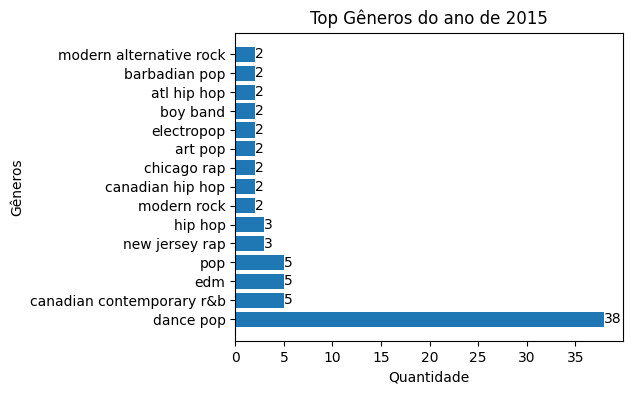

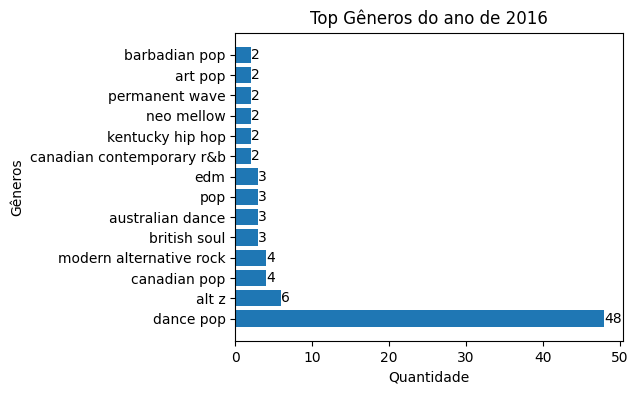

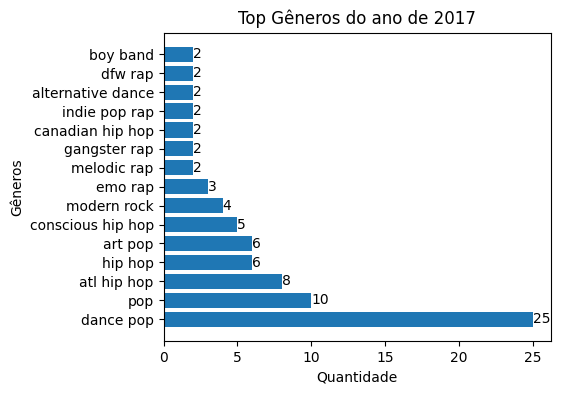

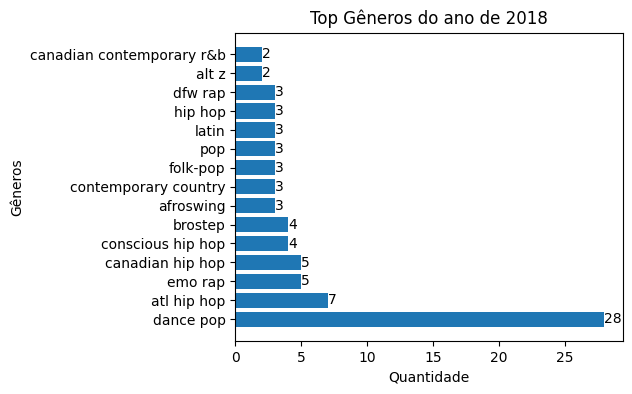

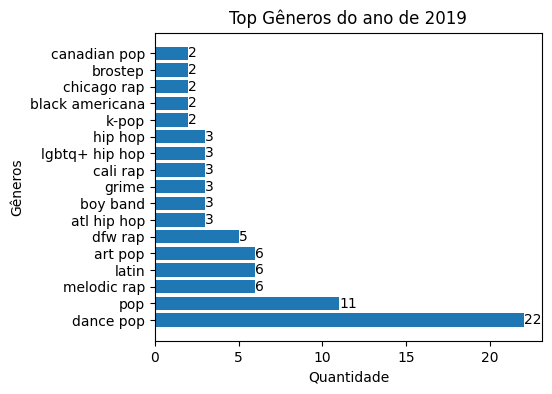

In [18]:
#Lendo ano a ano e plotando os gêneros musicais que apareceram mais de 1 vez no top 100 de cada ano
for i in years:
    df_teste = df.copy()
    df_teste = df_teste[df_teste['top year']==i]
    count = OrderedDict(Counter(df_teste[df_teste.duplicated(['top genre'], keep=False)]['top genre']).most_common())

    fig, ax = plt.subplots(figsize = (5,4))
    bars = ax.barh(list(count.keys()), count.values())

    ax.bar_label(bars)
    plt.title(f'Top Gêneros do ano de {i}')
    plt.xlabel(f'Quantidade')
    plt.ylabel(f'Gêneros')
    plt.show()

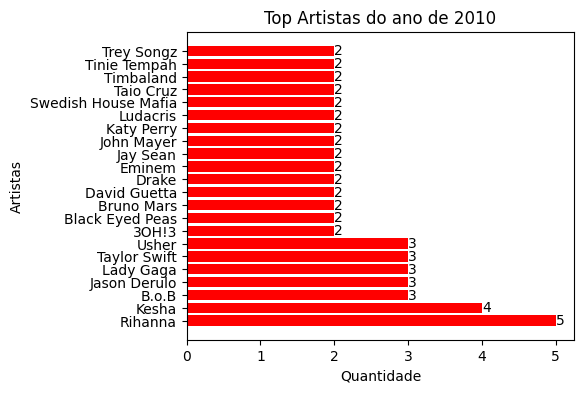

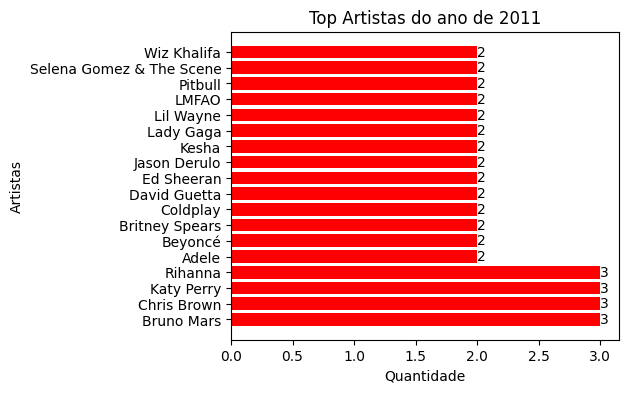

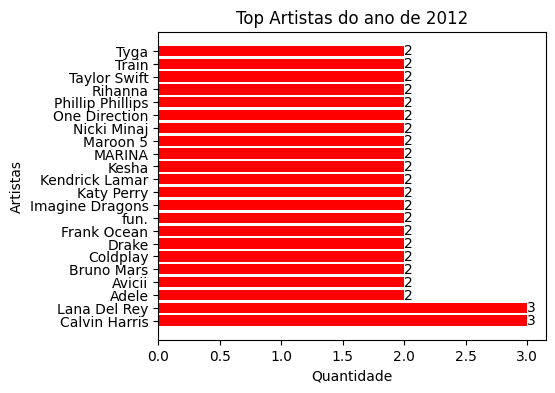

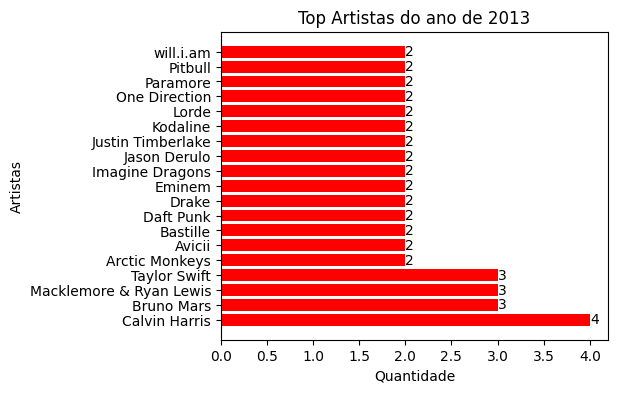

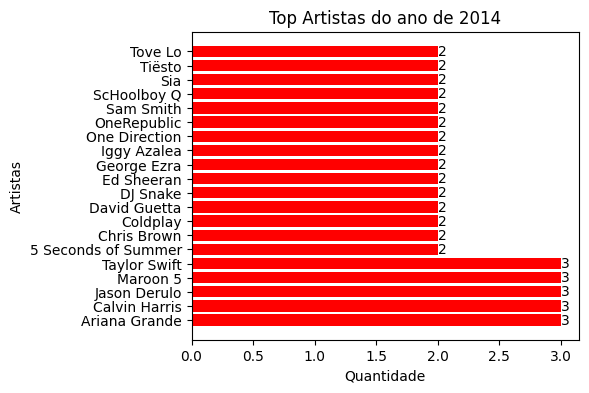

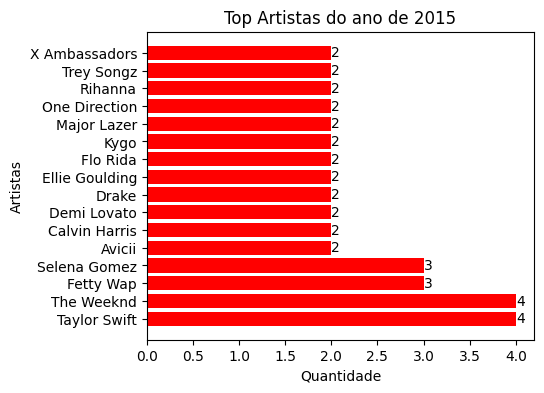

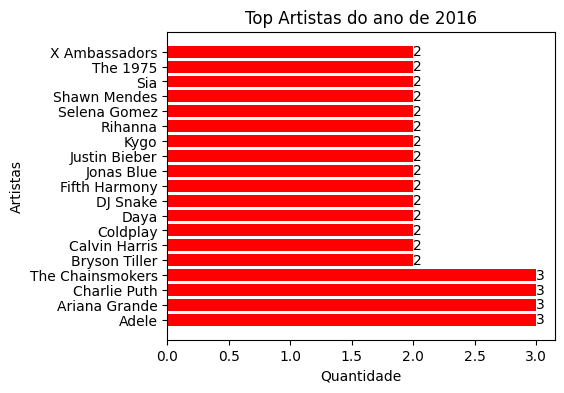

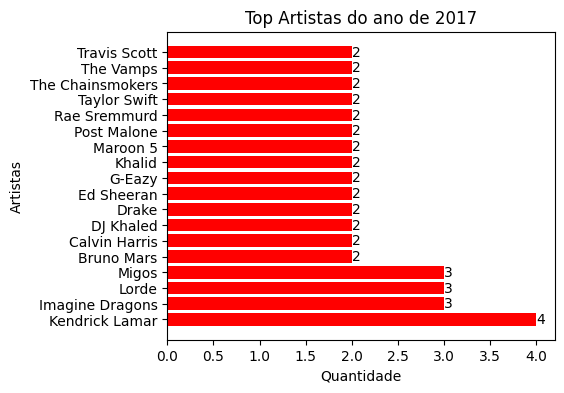

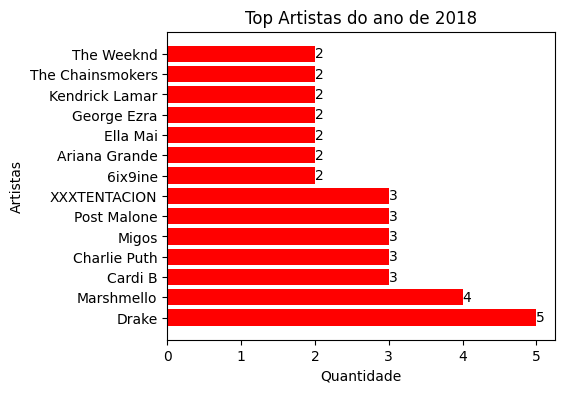

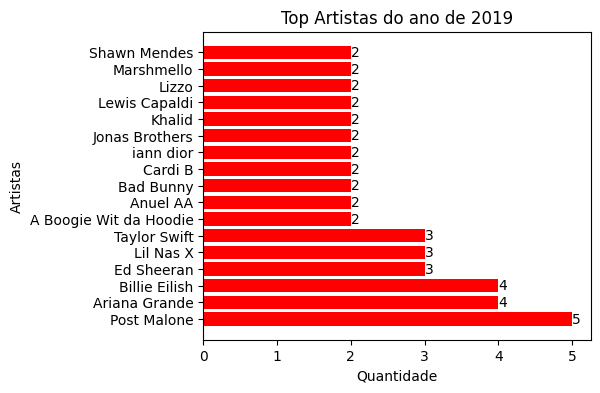

In [19]:
##Lendo ano a ano e plotando os artistas que apareceram mais de 1 vez no top 100 de cada ano
for i in years:
    df_teste = df.copy()
    df_teste = df_teste[df_teste['top year']==i]
    count = OrderedDict(Counter(df_teste[df_teste.duplicated(['artist'], keep=False)].artist).most_common())

    fig, ax = plt.subplots(figsize = (5,4))
    bars = ax.barh(list(count.keys()), count.values(), color = 'r')

    ax.bar_label(bars)
    plt.title(f'Top Artistas do ano de {i}')
    plt.xlabel(f'Quantidade')
    plt.ylabel(f'Artistas')
    plt.show()

#### 2- Qual a preferência das pessoas: música cantada ou instrumental? música acustica ou eletrônica?

##### 2.1- Cantada x Instrumental

In [20]:
df.describe().T.loc['spch']

count    1000.000000
mean       10.064000
std         9.276743
min         2.000000
25%         4.000000
50%         6.000000
75%        12.000000
max        53.000000
Name: spch, dtype: float64

O atributo spch representa o quanto falada é a música, variando entre 0 (apenas instrumentos) e 100 (totalmente falada, como um podcast). 

No caso no nosso dataset, o valor varia entre 2 e 53. Observa-se, então, a mediana e os 25% e 75% percentis, mostrando que a maioria dos valores estão concentrados mais próximos do mínimo.

Abaixo, mostram-se dois gráficos, boxplot e gráfico de linha, representando essa relação.

Assim, através dos dados, mostra-se uma tendência das músicas do top 100 destes anos serem menos faladas e com mais instrumentos.

{'whiskers': [<matplotlib.lines.Line2D at 0x7ff6cd9bab00>,
 'caps': [<matplotlib.lines.Line2D at 0x7ff6cd9ba770>,
 'boxes': [<matplotlib.lines.Line2D at 0x7ff6cd9bb9a0>],
 'medians': [<matplotlib.lines.Line2D at 0x7ff6cd9b8310>],
 'fliers': [<matplotlib.lines.Line2D at 0x7ff6cd9ba9b0>],
 'means': []}

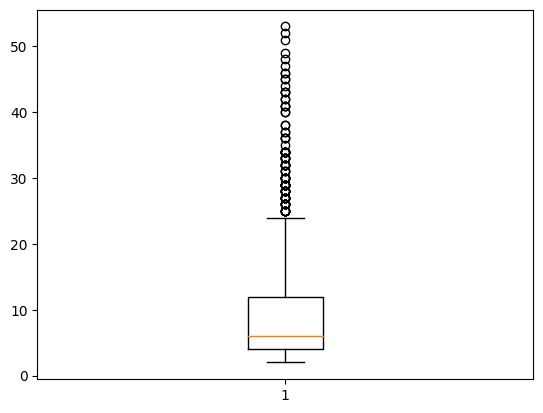

In [21]:
plt.boxplot(df['spch'])

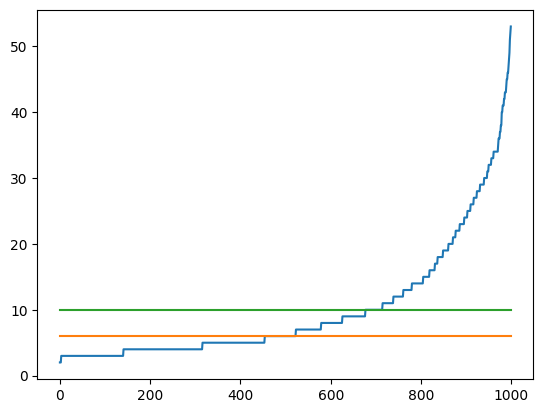

In [22]:
#75% percentil

plt.plot(sorted(list(df['spch'])))
plt.plot(np.ones(1000)*6)
plt.plot(np.ones(1000)*10)


##### 2.2- Acústica x Eletrônica

In [23]:
df.describe().T.loc['acous']

count    1000.00000
mean       14.36900
std        19.45403
min         0.00000
25%         2.00000
50%         6.00000
75%        19.00000
max        98.00000
Name: acous, dtype: float64

O atributo acous representa o quanto acústica é a música, variando entre 0 (mais eletrônica) e 100 (mais acústica).

No caso no nosso dataset, o valor varia entre 0 e 98. Observa-se, então, a mediana e os 25% e 75% percentis, mostrando que a maioria dos valores estão concentrados mais próximos do mínimo.

Abaixo, mostram-se dois gráficos, boxplot e gráfico de linha, representando essa relação.

Assim, através dos dados, mostra-se uma tendência das músicas do top 100 destes anos serem mais eletrônicas.
OBS.: Esse fato também pode ser evidenciado através do índice de correlação entre a energia da música e a acústica, sendo uma correlação forte negativa.

{'whiskers': [<matplotlib.lines.Line2D at 0x7ff6cd729e10>,
 'caps': [<matplotlib.lines.Line2D at 0x7ff6cd72a740>,
 'boxes': [<matplotlib.lines.Line2D at 0x7ff6cd7296c0>],
 'medians': [<matplotlib.lines.Line2D at 0x7ff6cd72b310>],
 'fliers': [<matplotlib.lines.Line2D at 0x7ff6cd72b6d0>],
 'means': []}

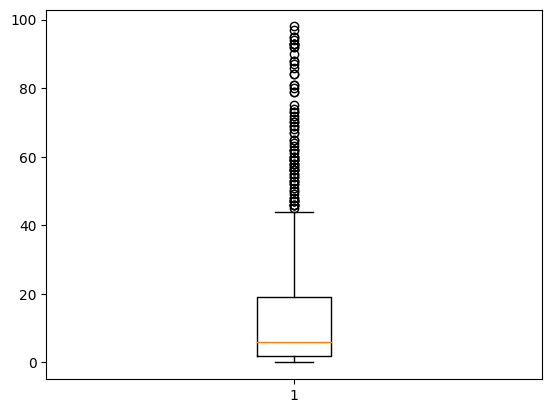

In [24]:
plt.boxplot(df['acous'])

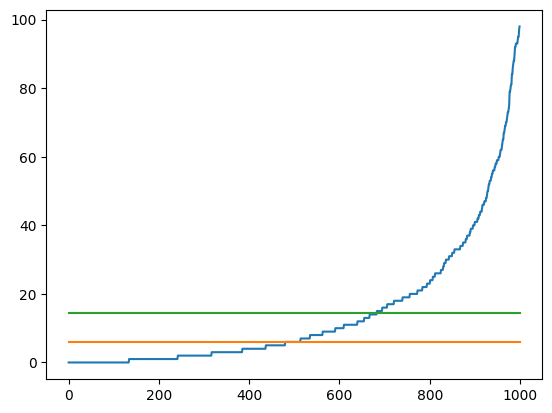

In [25]:
#75% percentil

plt.plot(sorted(list(df['acous'])))
plt.plot(np.ones(1000)*6)
plt.plot(np.ones(1000)*14.3)

#### 3- Qual a faixa de bpm mais escutada? 

(array([  3.,   7.,  24.,  30.,  27.,  48.,  58.,  89.,  52.,  28.,  42.,
         86., 119., 109.,  34.,  51.,  28.,  31.,  27.,  13.,  19.,  14.,
         13.,  15.,   9.,   5.,   8.,   4.,   2.,   5.]),
 array([ 65. ,  69.7,  74.4,  79.1,  83.8,  88.5,  93.2,  97.9, 102.6,
        107.3, 112. , 116.7, 121.4, 126.1, 130.8, 135.5, 140.2, 144.9,
        149.6, 154.3, 159. , 163.7, 168.4, 173.1, 177.8, 182.5, 187.2,
        191.9, 196.6, 201.3, 206. ]),
 <BarContainer object of 30 artists>)

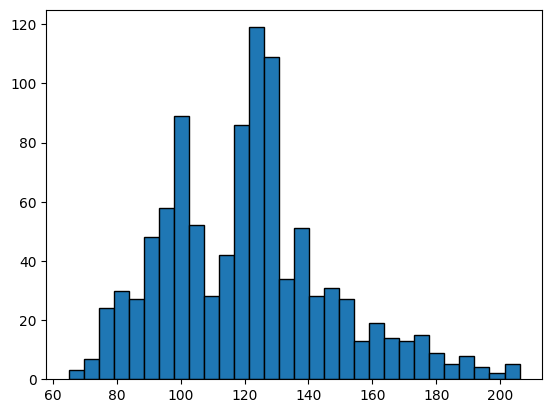

In [26]:
plt.hist(list(df.bpm), bins=30, ec='black') 

Analisando o Histograma, a Média e desvio padrão, nota-se que existe uma preferência por músicas de andamento Allegro (120 - 139 BPM)

#### 4- Existem mais música que geram sentimentos positivos ou negativos?

(array([ 3., 11., 17., 17., 34., 31., 33., 31., 28., 41., 58., 52., 48.,
        54., 42., 43., 55., 50., 39., 36., 39., 37., 50., 33., 35., 16.,
        22., 19., 13., 13.]),
 array([ 4. ,  7.1, 10.2, 13.3, 16.4, 19.5, 22.6, 25.7, 28.8, 31.9, 35. ,
        38.1, 41.2, 44.3, 47.4, 50.5, 53.6, 56.7, 59.8, 62.9, 66. , 69.1,
        72.2, 75.3, 78.4, 81.5, 84.6, 87.7, 90.8, 93.9, 97. ]),
 <BarContainer object of 30 artists>)

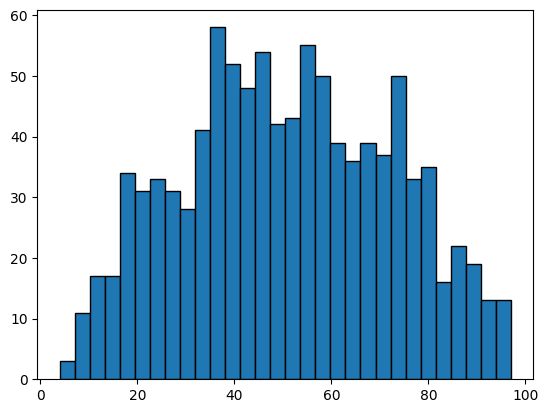

In [27]:
plt.hist(list(df.val), bins=30, ec='black') 

Analisando o Histograma, percebe-se que as músicas são bem balanceadas nesse quesito. Não existe uma preferência muito forte. Varia de pessoa para pessoa

#### 5 - 6 - 7 -> Qual a Correlação entre cada variável?

<AxesSubplot: >

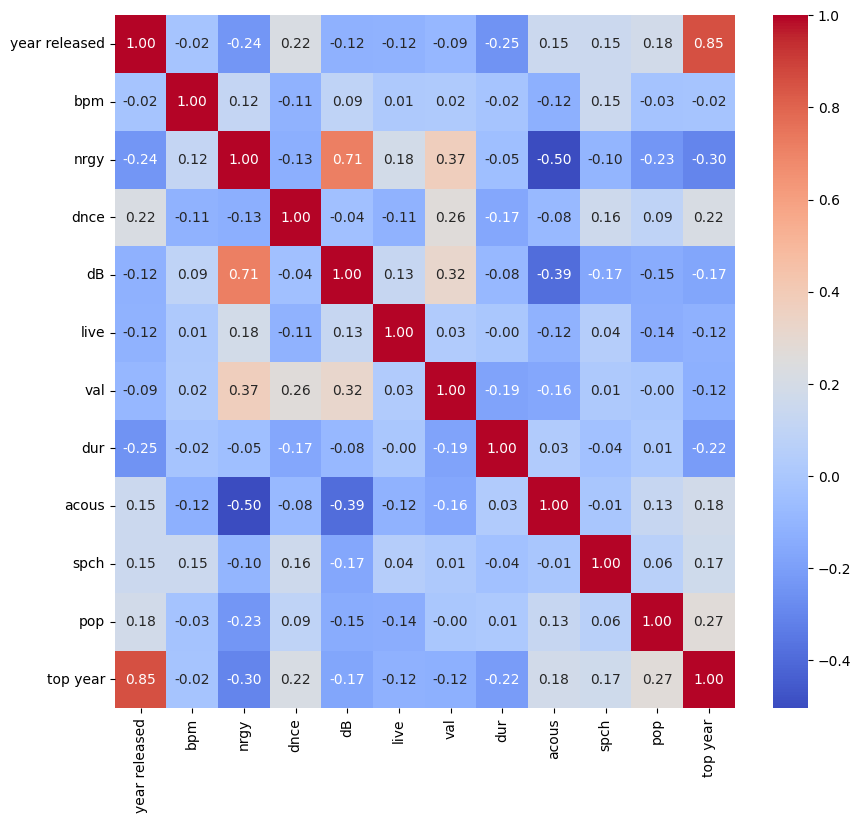

In [28]:
plt.figure(figsize=(10, 9))
sns.heatmap(df.corr(), cmap='coolwarm', annot=True, fmt='.2f')

# Legenda:
- Entre 0.7 e 0.89: correlação forte;
- Entre 0.40 e 0.69:  correlação moderada;
- Entre 0.1 e 0.39:correlação fraca; 
- (Vermelho)- correlação desprezível por ser da variável com ela mesma


### Correlação forte positiva entre energia e dB (0.71) e entre Ano de Lançamento com o Ano em que foi top (0,85). 

### Correlação fraca positiva entre dance e valence (0.26), entre valence e energia (0.37) e entre dB e Valence (0,32)

### Correlação moderada negativa entre energia e acustica(-0.50)

### As variáveis popularidade e BPM não parecem ter correlações consideráveis com nenhuma outra variável.

#### 8- Qual o máximo de anos que uma música permaneceu no top?

In [29]:
mais_um_ano = df['title'].value_counts().loc[lambda x : (x>= 2)]
mais_um_ano

Paradise                                              3
Sorry                                                 3
Don't                                                 3
History                                               2
Closer                                                2
No Hands (feat. Roscoe Dash & Wale)                   2
What's My Name?                                       2
Better Now                                            2
All My Friends (feat. Tinashe & Chance the Rapper)    2
I Knew You Were Trouble.                              2
Stole the Show                                        2
Talk Dirty (feat. 2 Chainz)                           2
Ho Hey                                                2
Post to Be (feat. Chris Brown & Jhene Aiko)           2
Sexy And I Know It                                    2
Latch                                                 2
SICKO MODE                                            2
I Love It (feat. Charli XCX)                    

Analisando a célula acima, vemos que o máximo de ano que uma música permaceu no TOP 100 foram 3 anos.

#### 9- Qual o tipo de artista mais tocado?


In [30]:
tipos_artistas = df['artist type'].value_counts()
tipos_artistas

Solo          748
Band/Group    169
Duo            70
Trio           13
Name: artist type, dtype: int64

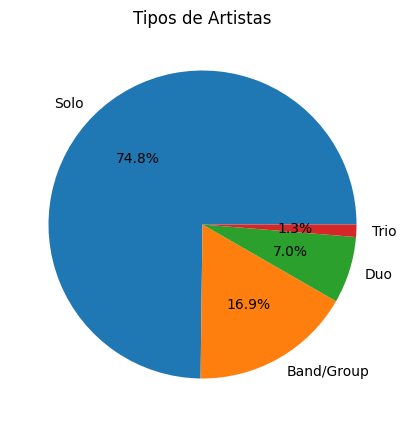

In [31]:
fig, ax = plt.subplots(figsize = (5,5))
ax.pie(tipos_artistas.values, labels = tipos_artistas.index, autopct='%1.1f%%')
plt.title(f'Tipos de Artistas')
plt.show()

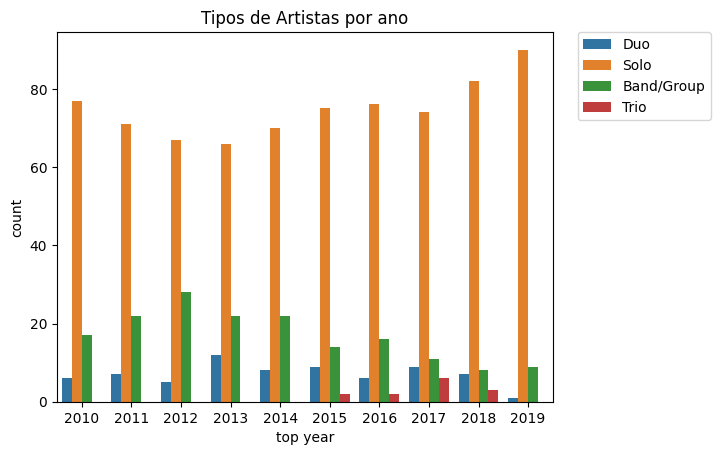

In [32]:
#Tipos de Artistas por Ano

ts_ty = sns.countplot(x="top year", hue="artist type", data=df).set(title='Tipos de Artistas por ano');
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);

O tipo de artista mais tocado foi Solo.

Houve um crescimento da presença de bandas em 2012.

Os trios começaram a aparecer a partir de 2015, tendo pico em 2017 e não estando presentes em 2019.

## Extra - Curiosidade

### Há músicas fora do período designado?

In [33]:
#viajantes do tempo, claro
display(df[~df['year released'].isin(years)].sort_values(by=['year released']))
print(len(df[~df['year released'].isin(years)]))

,title,artist,top genre,year released,added,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop,top year,artist type
982,Bohemian Rhapsody - Remastered 2011,Queen,classic rock,1975,2020‑06‑22,144,40.0,39.0,-10.0,24.0,23.0,354.0,29.0,5.0,77.0,2019,Band/Group
178,Good Life,OneRepublic,dance pop,2009,2020‑06‑16,95,69.0,63.0,-8.0,13.0,65.0,253.0,8.0,5.0,78.0,2011,Band/Group
99,BedRock,Young Money,dance pop,2009,2022‑02‑17,148,66.0,73.0,-6.0,19.0,56.0,288.0,10.0,30.0,76.0,2010,Band/Group
92,Say Aah (feat. Fabolous),Trey Songz,dance pop,2009,2022‑02‑17,93,87.0,72.0,-4.0,83.0,81.0,208.0,0.0,11.0,68.0,2010,Solo
86,If We Ever Meet Again (Featuring Katy Perry),Timbaland,dance pop,2009,2022‑02‑17,126,61.0,65.0,-7.0,6.0,39.0,293.0,0.0,4.0,74.0,2010,Solo
85,Carry Out (Featuring Justin Timberlake),Timbaland,dance pop,2009,2022‑02‑17,116,57.0,53.0,-7.0,26.0,27.0,232.0,11.0,11.0,74.0,2010,Solo
70,Riverside,Sidney Samson,dutch house,2009,2022‑02‑17,126,98.0,80.0,-2.0,13.0,29.0,321.0,0.0,5.0,42.0,2010,Solo
65,Hard,Rihanna,barbadian pop,2009,2022‑02‑17,182,75.0,31.0,-4.0,65.0,16.0,251.0,1.0,11.0,60.0,2010,Solo
59,Fireflies,Owl City,indietronica,2009,2022‑02‑17,180,66.0,51.0,-7.0,12.0,47.0,228.0,3.0,4.0,84.0,2010,Band/Group
50,Alejandro,Lady Gaga,art pop,2009,2022‑02‑17,99,79.0,62.0,-7.0,38.0,36.0,274.0,0.0,5.0,72.0,2010,Solo


34


### Média de cada atributo por ano

In [35]:
df_mean = df.groupby('top year').mean()
df_mean

,year released,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop
top year,,,,,,,,,,,
2010,2010.12,119.56,76.65,65.29,-4.95,20.66,56.74,226.45,9.62,9.95,70.18
2011,2011.06,127.29,76.10,63.56,-5.16,18.76,54.85,230.19,11.74,8.52,73.05
2012,2011.85,123.10,74.07,64.01,-5.53,19.71,53.29,226.38,9.70,9.27,72.85
2013,2012.73,119.91,72.44,63.55,-5.63,19.13,53.05,229.49,11.52,8.16,73.81
2014,2013.88,119.73,71.03,65.88,-5.46,18.66,50.95,227.90,12.29,7.65,74.32
2015,2014.93,120.86,67.53,65.22,-5.81,17.88,46.82,218.46,15.07,7.66,75.28
2016,2016.07,115.77,65.80,64.53,-5.97,17.12,46.92,219.86,18.42,10.22,75.09
2017,2016.99,122.02,63.16,73.58,-6.08,16.03,47.72,221.04,16.22,12.22,77.81
2018,2017.85,120.55,65.45,70.80,-5.83,15.77,47.56,208.79,18.15,13.15,77.58


### Quais palavras mais se repetem nos títulos do top 10

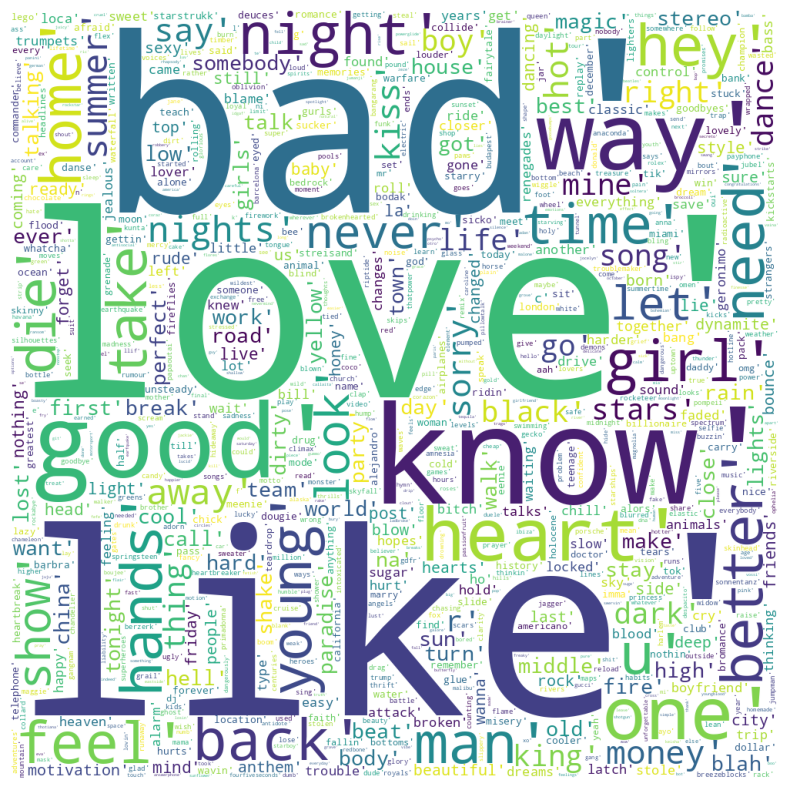

In [37]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from PIL import Image
from nltk.corpus import stopwords

df['title'] = df['title'].str.extract('([a-zA-Z ]+)', expand=False).str.strip()

def wordCloudFunction(df,column,numWords,mask=None):
    topic_words = [ z.lower() for y in
                       [ x.split() for x in df[column] if isinstance(x, str)]
                       for z in y]
    word_count_dict = dict(Counter(topic_words))
    popular_words = sorted(word_count_dict, key = word_count_dict.get, reverse = True)
    popular_words_nonstop = [w for w in popular_words if w not in stopwords.words("english")]
    word_string=str(popular_words_nonstop)
    wordcloud = WordCloud(stopwords=STOPWORDS,
                          background_color='white',
                          max_words=numWords,
                          width=1000,height=1000,
                          mask=mask
                         ).generate(word_string)
    plt.clf()
    plt.imshow(wordcloud)
    plt.axis('off')
    
plt.figure(figsize=(10,10))
wordCloudFunction(df,'title',10000000)

In [43]:
mask = df.apply(lambda r: r.astype(str).str.contains("love", case=False).title, axis=1)
display(df[mask])
#De 1000
len(df[mask])

,title,artist,top genre,year released,added,bpm,nrgy,dnce,dB,live,val,dur,acous,spch,pop,top year,artist type
17,Find Your Love,Drake,canadian hip hop,2010,2022‑02‑17,96,61.0,63.0,-6.0,3.0,76.0,209.0,2.0,17.0,70.0,2010,Solo
19,Stereo Love,Edward Maya,romanian house,2010,2022‑02‑17,127,78.0,80.0,-4.0,8.0,59.0,185.0,3.0,3.0,71.0,2010,Solo
22,Love The Way You Lie,Eminem,detroit hip hop,2010,2022‑02‑17,87,93.0,75.0,-5.0,52.0,64.0,263.0,24.0,23.0,87.0,2010,Solo
43,Your Love Is My Drug,Kesha,dance pop,2010,2022‑02‑17,120,61.0,83.0,-4.0,9.0,76.0,187.0,1.0,10.0,75.0,2010,Solo
105,Love On Top,Beyoncé,dance pop,2011,2020‑06‑16,94,75.0,65.0,-5.0,60.0,65.0,267.0,8.0,9.0,79.0,2011,Solo
107,Skinny Love,Birdy,pop,2011,2020‑06‑16,166,29.0,38.0,-8.0,12.0,17.0,201.0,95.0,5.0,77.0,2011,Solo
135,Stereo Love,Edward Maya,romanian house,2010,2020‑06‑16,127,78.0,80.0,-4.0,8.0,59.0,185.0,3.0,3.0,71.0,2011,Solo
164,How To Love,Lil Wayne,hip hop,2011,2020‑06‑16,154,66.0,64.0,-6.0,11.0,27.0,240.0,0.0,4.0,72.0,2011,Solo
185,We Found Love,Rihanna,barbadian pop,2011,2020‑06‑16,128,77.0,74.0,-4.0,11.0,60.0,215.0,3.0,4.0,80.0,2011,Solo
189,Love You Like A Love Song,Selena Gomez & The Scene,dance pop,2011,2020‑06‑16,117,68.0,86.0,-4.0,7.0,92.0,188.0,8.0,5.0,85.0,2011,Band/Group


56

## Extra - Pandas Profiling

In [39]:
from pandas_profiling import ProfileReport
profile_report = ProfileReport(df)
profile_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# DECIDIR O Q FAZER COM ISSO AQUI

In [ ]:

print(Counter(df[df.duplicated(['title'], keep=False)].title))

df[df.duplicated(['title'])]


In [ ]:


years = df['top year'].unique()

for i in years:
    df_teste = df.copy()
    df_teste = df_teste[df_teste['top year']==i]
    count = OrderedDict(Counter(df_teste[df_teste.duplicated(['artist'], keep=False)].artist).most_common())
    plt.figure(figsize=(3, 3))
    plt.title(f"{i}")
    plt.barh(list(count.keys()), count.values())


In [ ]:
count = OrderedDict(Counter(df[df.duplicated(['artist'], keep=False)].artist).most_common())
plt.figure(figsize=(8, 32))
plt.barh(list(count.keys()), count.values())

#df[df.duplicated(['artist'])]

In [ ]:
# Análise do "Added"
for i in years:
    print(int(i))
    print(Counter(df[df['top year'] == i]['added']))
    print(len(df[df['top year'] == i]['added'].unique()))
    print()

In [ ]:

years = df['top year'].unique()

for i in years:
    df_teste = df.copy()
    df_teste = df_teste[df_teste['top year']==i]
    count = OrderedDict(Counter(df_teste[df_teste.duplicated(['top genre'], keep=False)]['top genre']).most_common())
    plt.figure(figsize=(3, 3))
    plt.title(f"{i}")
    plt.barh(list(count.keys()), count.values(), color='red')

In [ ]:

count = OrderedDict(Counter(df['top genre']).most_common())
plt.figure(figsize=(10, 20))
plt.barh(list(count.keys()), count.values(), color='red')


In [ ]:
!pip install pandas_profiling

In [ ]:
from pandas_profiling import ProfileReport
profile_report = ProfileReport(df)
profile_report

In [ ]:
pd.pivot_table(df, index = 'artist type', 
               columns = 'top year', values = 'artist' ,aggfunc ='count')

In [ ]:
'Solo artists have instances of the highest speechiness'
'[note the increasing popularity of hip hop and rap]'
dfM = df
spotify = df
plt.figure(figsize=(10,10))
s_ty = sns.stripplot(x=dfM['artist type'], y=dfM['spch'], data=dfM)
s_ty.set_title('Speechiness by Artist Type, 2010-2019')
s_ty.set_ylabel('Speechiness')
s_ty.set_xlabel('Artist Type');

In [ ]:
dfM= df
spotify = df

In [ ]:
dfM_Mean = dfM.groupby('top year').mean()
dfM_Mean

In [ ]:
df.shape
df.columns

In [ ]:
spotify.nunique()

In [ ]:
categories= spotify['artist type'].value_counts().index.tolist() #Categories from the artist type
values= spotify['artist type'].value_counts().values.tolist()    #Values from the artist type
fig1 = px.pie(spotify, values=values, names=categories, color_discrete_sequence=px.colors.sequential.Aggrnyl,title='% artist type' )
fig1.update_layout(
    font_family="Courier New",
    font_color="blue",
    title_font_family="Times New Roman",
    title_font_color="blue",
    title_x=0.50,
    title_font=dict(size=30)
    
)
fig1.show()

#grafico de pizza - colcoar com o pyplot

In [ ]:
#https://www.kaggle.com/code/agustin222/spotify-visual-and-eda

In [ ]:
plt.figure(figsize=(10,8))
plt.title('Top Genre in Spotify',fontsize=15, fontweight='bold')
ax = sns.countplot(x="top genre", data=spotify, palette="Set3", order=spotify['top genre'].value_counts().index[0:15])
plt.xticks(rotation=45);

In [ ]:
index=spotify['artist'].value_counts()[spotify['artist'].value_counts()>5].index.tolist()
val=spotify['artist'].value_counts()[spotify['artist'].value_counts()>5].values.tolist()
plt.rcParams['figure.figsize']=16,5
clrs = ['grey' if (x < val[4]) else 'red' for x in val ]
ax= sns.barplot(x=index, y=val, palette=clrs) #colors clrs
plt.xticks(rotation=90)
for i in ax.containers:
    ax.bar_label(i)
plt.title('Artists with more than 5 hits',fontsize=15, fontweight='bold');
plt.show()

In [ ]:
#Top artista por gênero (top 5 generos)

In [ ]:
# Fazer a correlação usando também as variaveis de texto

In [ ]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from PIL import Image
from collections import Counter
from nltk.corpus import stopwords

#Avoid the brackets, they have the singer names and words like feat,etc.
spotify['title'] = spotify['title'].str.extract('([a-zA-Z ]+)', expand=False).str.strip()

def wordCloudFunction(df,column,numWords,mask=None):
    topic_words = [ z.lower() for y in
                       [ x.split() for x in df[column] if isinstance(x, str)]
                       for z in y]
    word_count_dict = dict(Counter(topic_words))
    popular_words = sorted(word_count_dict, key = word_count_dict.get, reverse = True)
    popular_words_nonstop = [w for w in popular_words if w not in stopwords.words("english")]
    word_string=str(popular_words_nonstop)
    wordcloud = WordCloud(stopwords=STOPWORDS,
                          background_color='white',
                          max_words=numWords,
                          width=1000,height=1000,
                          mask=mask
                         ).generate(word_string)
    plt.clf()
    plt.imshow(wordcloud)
    plt.axis('off')
    
plt.figure(figsize=(15,15))
comments_mask =np.array(Image.open( 'upvote.png'))
wordCloudFunction(spotify,'title',10000000)

In [ ]:
#Aplicadno paleta de cores da imagem no trem

import re
text = " ".join(title for title in df.title)
text = "".join(re.split("\(|\)|\[|\]", text)[::2])
text = text.replace('Edit ', '')
text = text.replace('Radio ', '')
text = text.replace('Remix', '')

#custom_mask = np.array(Image.open("upvote.png"))
word_cloud = WordCloud(collocations = False, background_color = 'white').generate(text)

image_colors = ImageColorGenerator(custom_mask)
word_cloud.recolor(color_func=image_colors)

plt.imshow(word_cloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [ ]:

#viagem no tempo
#viajantes do tempo, claro
spotify['year released'].value_counts()
df[df['year released'] == 1975]
display(df[~df['year released'].isin(years)].sort_values(by=['year released']))
len(df[~df['year released'].isin(years)])

In [ ]:
#Are there songs within the top that are outside the decade, that is, songs released outside the range?


In [ ]:
#Have the songs become sadder?
# How has the energy variable evolved?
# How has the danceability variable evolved?
# 

In [ ]:
genres_year = df[['top genre', 'top year']]
genres_year = genres_year.rename(columns={'top year':'top_year'})
def cont_gen(ds):
    years = range(2010, 2020)
    y_g = pd.DataFrame()
    for i in years:
        col = ds[ds.top_year == i]['top genre'].value_counts()
        col = col[:3]
        col.to_frame()
        col = col.rename(str(i))
        y_g = y_g.append(col)

    return y_g

genres_years = cont_gen(genres_year)
genres_years

f1 = plt.figure()
colors = ['tomato','lightseagreen', 'Aqua', 'Firebrick', 'DarkViolet', 'Gainsboro', 'Olive', 'Gold', 'Pink', 'Black', 'Blue', 'Red']
plt.style.use('seaborn-darkgrid')
genres_years.plot(kind='bar', ax=f1.gca(), stacked=True ,figsize=(10,9), color=colors, ylabel='Number of songs in the top', xlabel='Years', title='Most popular genres of the decade')
plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
plt.show()

In [ ]:
df.groupby('artist')['artist'].count().sort_values(ascending=False)

In [ ]:
artist_decade = df[['artist', 'top year']]
artist_decade = artist_decade.rename(columns={'top year':'top_year'})
def cont_art(ds):
    years = range(2010, 2020)
    a_d = pd.DataFrame()
    for i in years:
        col = ds[ds.top_year == i]['artist'].value_counts()
        col = col[:3]
        col.to_frame()
        col = col.rename(str(i))
        a_d = a_d.append(col)

    return a_d

artist_decades = cont_art(artist_decade)
artist_decades

In [ ]:
sad = df[['val', 'top year']]
sad = sad.rename(columns={'top year':'top_year'})
def cont_sad(ds):
    years = range(2010, 2020)
    s = {}
    for i in years:
        sa = sad[sad.top_year == i]
        pro = sa.mean()
        s[i] = pro[0]
    return s
sad1 = cont_sad(sad)
sad1 = pd.DataFrame(sad1.items(), columns=['year', 'prom_sad'])
sad1

sns.set_theme(style="darkgrid")
f3 = sns.lineplot(data=sad1, x="year", y="prom_sad")
f3.set_title('Graph of the change in the mood of the songs in the decade 2010-2019')
f3.set_ylabel('Positivity of the songs')
f3.set_xlabel('Years')
plt.show()

In [ ]:
nrgy = df[['nrgy', 'top year']]
nrgy = nrgy.rename(columns={'top year':'top_year'})
def cont_nrgy(ds):
    years = range(2010, 2020)
    s = {}
    for i in years:
        sa = nrgy[nrgy.top_year == i]
        pro = sa.mean()
        s[i] = pro[0]
    return s
energy = cont_nrgy(nrgy)
energy = pd.DataFrame(energy.items(), columns=['year', 'prom_energy'])
energy

sns.set_theme(style="darkgrid")
f4 = sns.lineplot(data=energy, x="year", y="prom_energy")
f4.set_title('Graph of the change of energy of the songs in the decade 2010-2019')
f4.set_ylabel('Energy of the songs')
f4.set_xlabel('Years')
plt.show()

In [ ]:
dnce = df[['dnce', 'top year']]
dnce = dnce.rename(columns={'top year':'top_year'})
def cont_dnce(ds):
    years = range(2010, 2020)
    s = {}
    for i in years:
        sa = dnce[dnce.top_year == i]
        pro = sa.mean()
        s[i] = pro[0]
    return s
dance = cont_dnce(dnce)
dance = pd.DataFrame(dance.items(), columns=['year', 'prom_dance'])
dance

sns.set_theme(style="darkgrid")
f5 = sns.lineplot(data=dance, x="year", y="prom_dance")
f5.set_title('Graph of the change of danceability of the songs in the decade 2010-2019')
f5.set_ylabel('Danceability of the songs')
f5.set_xlabel('Years')
plt.show()

In [ ]:
sns.set_theme(style="darkgrid")
f5 = sns.lineplot(data=dance, x="year", y="prom_dance")
f4 = sns.lineplot(data=energy, x="year", y="prom_energy")
f3 = sns.lineplot(data=sad1, x="year", y="prom_sad")
f5.set_xlabel('Years')
plt.show()

In [ ]:
"The data has some inconsistencies such as the 'dB' category, which has negative values."

In [ ]:
#https://www.kaggle.com/code/surendra01/expert-level-seaborn-viz

In [ ]:
#1) kdeplot
#A kernel density estimate (KDE) plot is a method for visualizing the distribution of observations in a dataset, analagous to a histogram. KDE represents the data using a continuous probability density curve in one or more dimensions.

# basic kdeplot
sns.kdeplot(df['bpm']);

In [ ]:
plt.figure(figsize = (10,6))      # to increase the size of plot 
sns.kdeplot(df['bpm'],
            color = 'brown',       # to change the color 
            shade = True)          # fill the graph 
plt.title('Distrubution of bpm',       # giving title to a grpah
          fontsize = 20)               # to increase the size of title

plt.xlabel('bpm', fontsize = 14)
plt.ylabel('density', fontsize = 14);

In [ ]:
#2) Displot
# Seaborn distplot lets you show a histogram with a line on it. This can be shown in all kinds of variations. We use seaborn in combination with matplotlib, the Python plotting module.

In [ ]:
# basic plot
sns.displot(df['nrgy']); 

In [ ]:
plt.figure(figsize = (7,7))
sns.displot(df['nrgy'],  bins = 27,
            kde = True,        # with histogram it also implement smooth curve 
            color = '#E24A33');   # specify  the color

plt.title('Distribution of nrgy', fontsize = 15)

In [ ]:
#3) Histplot
#A histogram is a classic visualization tool that represents the distribution of one or more variables by counting the number of observations that fall within disrete bins.

In [ ]:
plt.figure(figsize = (6,6))
sns.histplot(x = df['live'],
             binwidth = 4,   # size of one bin
             bins = 24,      # number of bins
             kde = True,     # curve of distribution
             color = 'gold',
            alpha = 0.7);

In [ ]:
#4)Scatter Plot
#The scatter plot is a mainstay of statistical visualization. It depicts the joint distribution of two variables using a cloud of points, where each point represents an observation in the dataset.

In [ ]:
sns.scatterplot(data = df,
                x = 'spch',
                y = 'dnce');

In [ ]:
plt.figure(figsize = (12,6))
sns.scatterplot(data = df,
                x = 'spch',
                y = 'dnce',
                hue = 'artist type',
                palette = 'rocket',    # categorical variable
                s = 50 );     # size of dots

plt.title('spch Vs dnce', fontsize = 15)

In [ ]:
#5) Jointplot
#Joint plot is used to get the distribution of individual variable and relationship between

In [ ]:
plt.figure(figsize = (12,6))
sns.jointplot(data = df,
                x = 'spch',
                y = 'dnce');

In [ ]:
plt.figure(figsize = (12,12))

sns.jointplot(data = df,
                x = 'spch',
                y = 'dnce',
                hue = 'artist type',    # for categorical
              palette = 'twilight');

In [ ]:
#6)Lineplot
#Whenever in dataset there is date column then we can use line plot

In [ ]:
plt.figure(figsize = (12,6))
sns.lineplot(data = df, x = 'top year', y = 'live');

In [ ]:
#Light blue shade is the 95% confidence interval around the mean.
#It is clear trend that over the year liveness is reduced

In [ ]:
#7) Rel Plot
#This function provides access to several different axes-level functions that show the relationship between two variables with semantic mappings of subsets. The kind parameter selects the underlying axes-level function to use:

In [ ]:
sns.relplot(x = 'year released',
            y = 'val',
            data = df,
            kind= 'line', 
            color = 'olive');

In [ ]:
#8) Pair Plot
#Pairplot make matrix of plot in which diagonal plot are single variable histogram plot and non diagonal are scatterplot

In [ ]:
sns.pairplot(df)

In [ ]:
sns.pairplot(df[['bpm', 'nrgy', 'dnce']],
            plot_kws={'color':'black'},   # make changes in non diagonal, kws stand for key words argument
            diag_kws = {'color': 'red'});  # make changes in diagonal

In [ ]:
#9)Facet Grid
#Facetgrid maps a dataset onto multiple axes arrayed in a grid of rows and columns that correspond to levels of variables in the dataset. The plots it produces are often called “lattice”, “trellis”, or “small-multiple” graphics

In [ ]:
# facet grid for double  variable
g = sns.FacetGrid(df, 
                  sharey = False,        # setting up y axis 
                  ylim = (20,100),       # giving the y limit
                  col = 'artist type')    # spciefy the category
g.map_dataframe(sns.scatterplot,              # spciefy the type of grpah
                 x = 'pop', y = 'dnce',
                color = 'forestgreen' , alpha = 0.7);              # numerical varible

g.set_axis_labels('popularity', 'danceability');

In [ ]:
#
#10)Strip Plot
#A strip plot is very simple to understand. It is basically a scatter plot that differentiates different categories. So, all the data that corresponds to each category is shown as a scatter plot, and all the observations and collected data that are visualized are shown, side-by-side on a single graph.

In [ ]:
from ipywidgets import interactive    # make interactive graph and we can do with any grpah

def jitter_widget(jitter=0.1, linewidth = 0.3):
    plt.figure(figsize = (12,6))

    sns.stripplot(y = df['artist type'], x = df['val'], 
                  linewidth = linewidth,             
                  jitter=jitter)                    #  show the overlap

In [ ]:
interactive(jitter_widget, jitter=(0, 0.65, 0.05), linewidth = (0,1, 0.05))

In [ ]:
#11)Boxplot
#Box plot give the quartile distribution of varaible, box plot is very useful to find the outlier

In [ ]:
plt.figure(figsize = (12,6))
sns.boxplot(data = df,
            x = 'artist type',   # categorical variable
            y = 'pop',           # numerical variable
            palette = 'Set3');

In [ ]:
#12)Bar plot
#A bar plot represents an estimate of central tendency for a numeric variable with the height of each rectangle and provides some indication of the uncertainty around that estimate using error bars.


In [ ]:
sns.barplot(data = df,
            x = 'artist type',
            y = 'nrgy')

In [ ]:
#Which songs has the most BPM, energia
df['bpm'].sort_values(ascending=False)

In [ ]:
df[df['bpm'] == 206]

In [ ]:
df.iloc[[70,312]]